In [1]:
import os
import scanpy as sc
import pandas as pd
import numpy as np
import anndata as ad
import seaborn as sns
import scipy.sparse as sp
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

sc.settings.verbosity = 0
sc.settings.set_figure_params(dpi=50, dpi_save=500)
from matplotlib import rcParams
rcParams["figure.dpi"] = 50
rcParams["savefig.dpi"] = 500

In [2]:
data_dir = '../../../Data/Spatial/Transcriptomics/MERFISH_FCandS_Allen2023/'
if not os.path.exists(data_dir + 'processed/'):
    os.makedirs(data_dir + 'processed/')

In [3]:
adata_concat = ad.read_h5ad(data_dir + 'BrainAgingSpatialAtlas_MERFISH.h5ad')
adata_concat

AnnData object with n_obs × n_vars = 378918 × 374
    obs: 'fov', 'center_x', 'center_y', 'min_x', 'max_x', 'min_y', 'max_y', 'age', 'clust_annot', 'slice', 'organism_ontology_term_id', 'sex_ontology_term_id', 'suspension_type', 'cell_type_ontology_term_id', 'assay_ontology_term_id', 'tissue_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'development_stage_ontology_term_id', 'donor_id', 'is_primary_data', 'cell_type_annot', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observation_joinid'
    var: 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 'feature_length', 'feature_type'
    uns: 'batch_condition', 'citation', 'schema_reference', 'schema_version', 'title'
    obsm: 'X_pca', 'X_spatial_coords', 'X_umap', 'spatial_coords'

In [ ]:
adata_concat_new = ad.AnnData(X=adata_concat.raw.X.copy())
adata_concat_new.obs_names = adata_concat.obs_names.copy()
adata_concat_new.var_names = list(adata_concat.var['feature_name'].reindex(adata_concat.var_names))
adata_concat_new.var['feature_name'] = adata_concat.var['feature_name'].copy()
adata_concat_new.obs['celltype_43'] = adata_concat.obs['clust_annot'].copy()
adata_concat_new.obs['celltype_coarse'] = adata_concat.obs['cell_type_annot'].copy()
adata_concat_new.obs['domain_annotation'] = adata_concat.obs['tissue'].copy()
obs_list = ['donor_id', 'slice', 'age', 'development_stage']
for key in obs_list:
    adata_concat_new.obs[key] = adata_concat.obs[key].copy()
adata_concat_new.obsm['spatial'] = adata_concat.obsm['X_spatial_coords']
adata_concat_new

AnnData object with n_obs × n_vars = 378918 × 374
    obs: 'celltype_43', 'celltype_coarse', 'domain_annotation', 'donor_id', 'slice', 'age', 'development_stage'
    var: 'feature_name'
    obsm: 'spatial'

In [5]:
slice_name_list_4wk = []
slice_name_list_24wk = []
slice_name_list_90wk = []
adata_list = []

for i in range(1, 13):

    adata_donor = adata_concat_new[adata_concat_new.obs['donor_id'] == f'MsBrainAgingSpatialDonor_{i}', :].copy()
    slices = sorted(set(adata_donor.obs['slice']))
    print(f'MsBrainAgingSpatialDonor_{i}: {len(slices)} slices')

    for j in slices:

        adata = adata_donor[adata_donor.obs['slice'] == j, :].copy()
        age = list(set(adata.obs['age']))[0]
        if age == '4wk':
            slice_name_list_4wk.append(f'Donor{i}_Slice{j}_{age}')
        elif age == '24wk':
            slice_name_list_24wk.append(f'Donor{i}_Slice{j}_{age}')
        else:
            slice_name_list_90wk.append(f'Donor{i}_Slice{j}_{age}')
        adata_list.append(adata)
        print(adata.shape)

#         adata.write_h5ad(data_dir + f'processed/Donor{i}_Slice{j}_{age}.h5ad')

# with open(data_dir + "processed/slice_name_list_all.txt", "w") as f:
#     for file_name in slice_name_list_4wk + slice_name_list_24wk + slice_name_list_90wk:
#         f.write(file_name + '\n')

# with open(data_dir + "processed/slice_name_list_4wk.txt", "w") as f:
#     for file_name in slice_name_list_4wk:
#         f.write(file_name + '\n')

# with open(data_dir + "processed/slice_name_list_24wk.txt", "w") as f:
#     for file_name in slice_name_list_24wk:
#         f.write(file_name + '\n')

# with open(data_dir + "processed/slice_name_list_90wk.txt", "w") as f:
#     for file_name in slice_name_list_90wk:
#         f.write(file_name + '\n')

MsBrainAgingSpatialDonor_1: 1 slices
(21002, 374)
MsBrainAgingSpatialDonor_2: 2 slices
(15694, 374)
(24790, 374)
MsBrainAgingSpatialDonor_3: 2 slices
(19503, 374)
(15844, 374)
MsBrainAgingSpatialDonor_4: 3 slices
(9571, 374)
(11047, 374)
(10890, 374)
MsBrainAgingSpatialDonor_5: 3 slices
(10744, 374)
(9644, 374)
(8983, 374)
MsBrainAgingSpatialDonor_6: 3 slices
(9462, 374)
(8164, 374)
(8281, 374)
MsBrainAgingSpatialDonor_7: 3 slices
(10785, 374)
(10609, 374)
(11398, 374)
MsBrainAgingSpatialDonor_8: 3 slices
(14122, 374)
(12180, 374)
(12036, 374)
MsBrainAgingSpatialDonor_9: 3 slices
(11179, 374)
(12421, 374)
(10268, 374)
MsBrainAgingSpatialDonor_10: 3 slices
(9665, 374)
(9617, 374)
(8823, 374)
MsBrainAgingSpatialDonor_11: 3 slices
(7545, 374)
(14195, 374)
(7215, 374)
MsBrainAgingSpatialDonor_12: 2 slices
(17503, 374)
(15738, 374)


In [6]:
slice_name_list = np.loadtxt(data_dir + f"processed/slice_name_list_all.txt", dtype=str, delimiter=" ").tolist()

adata_list = []
for slice_name in slice_name_list:
    adata = ad.read_h5ad(data_dir + 'processed/' + slice_name + '.h5ad')
    adata_list.append(adata)

adata_concat_new = ad.concat(adata_list, label='slice_name', keys=slice_name_list)
adata_concat_new

AnnData object with n_obs × n_vars = 378918 × 374
    obs: 'celltype_43', 'celltype_coarse', 'domain_annotation', 'donor_id', 'slice', 'age', 'development_stage', 'slice_name'
    obsm: 'spatial'

In [7]:
domains = sorted(set(adata_concat_new.obs[f'domain_annotation']))
domain_color_dict = {f'{domains[i]}': sns.color_palette()[i] for i in range(len(domains))}

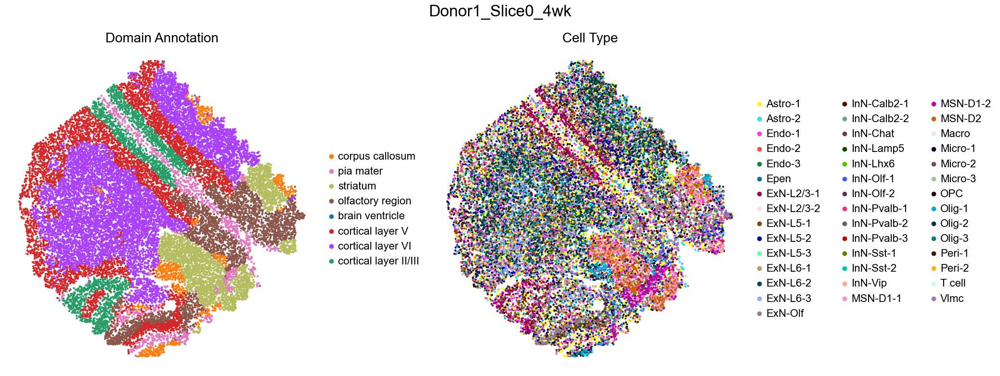

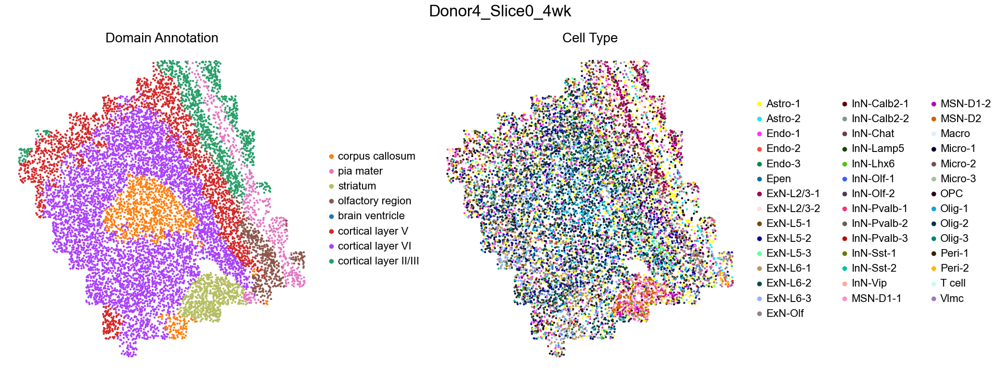

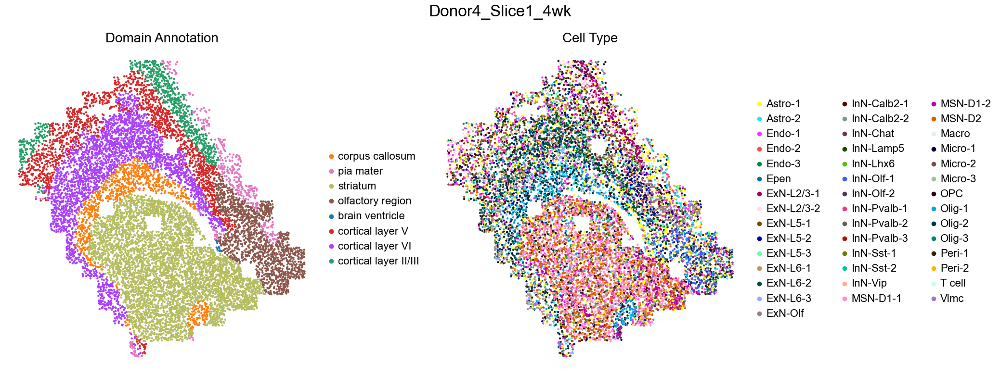

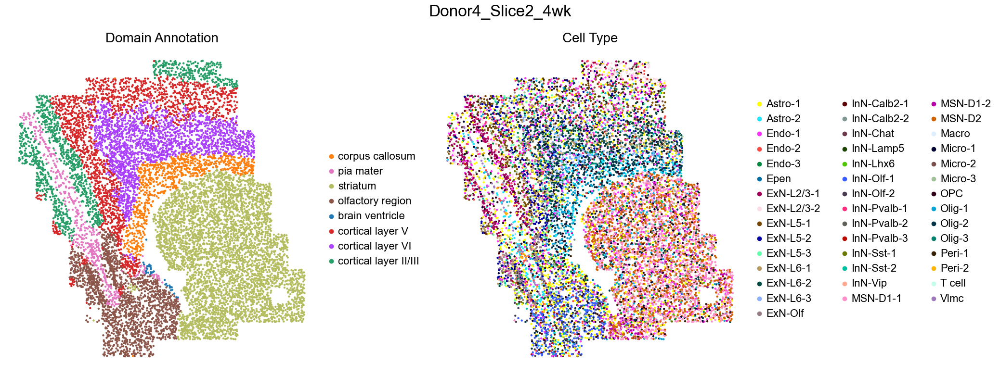

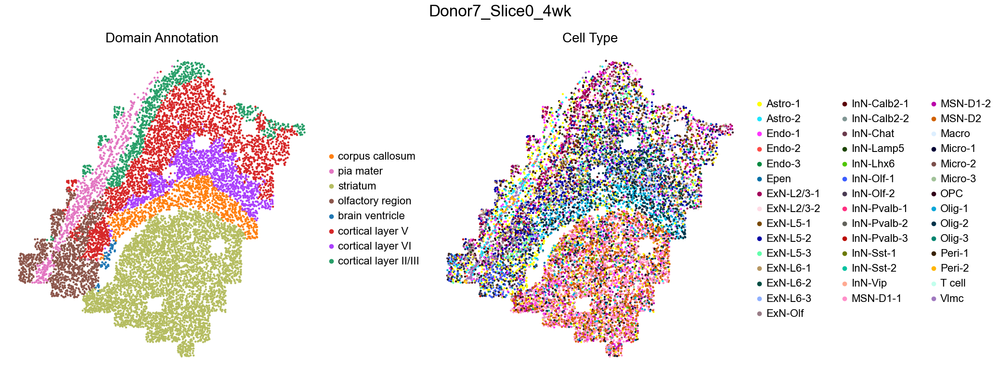

...

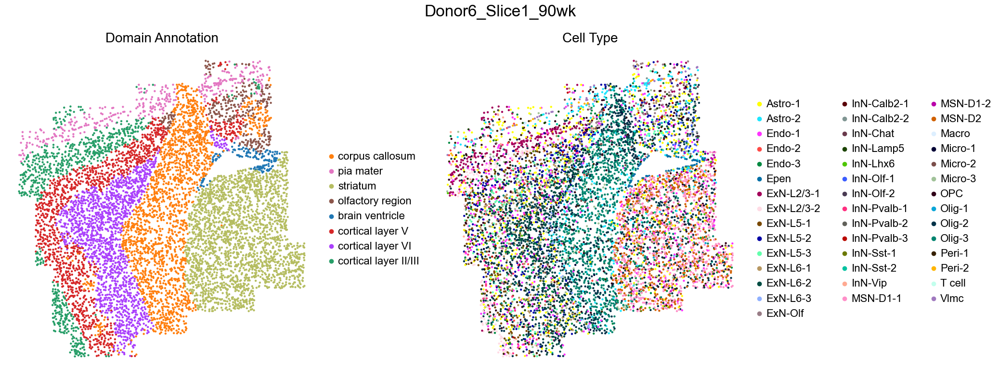

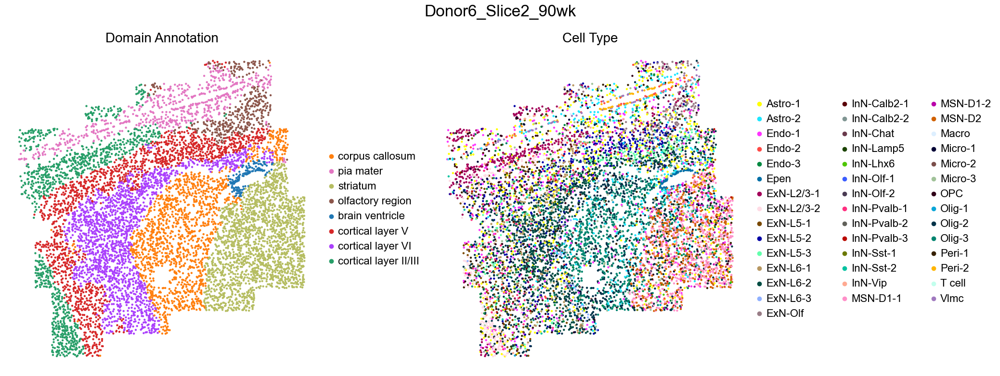

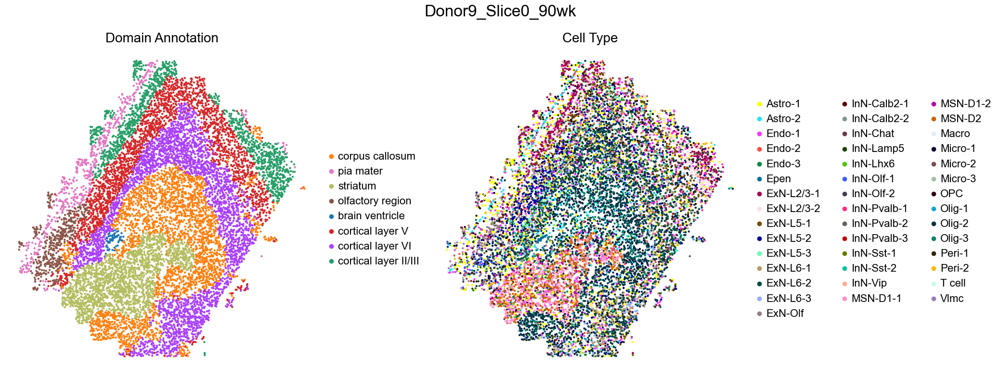

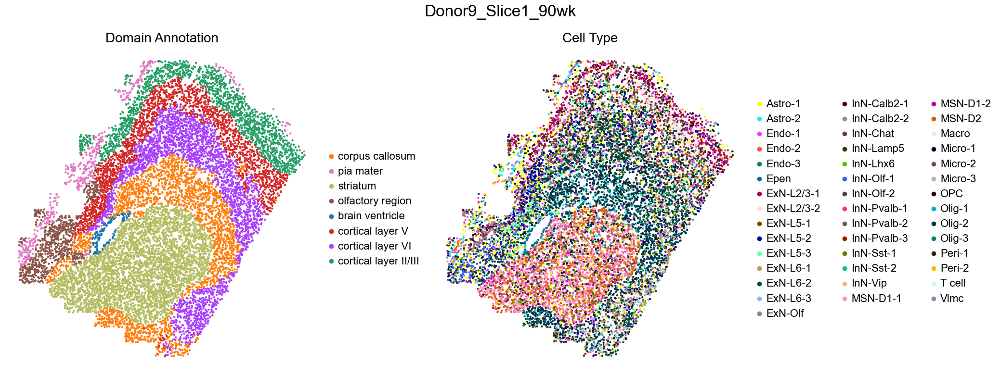

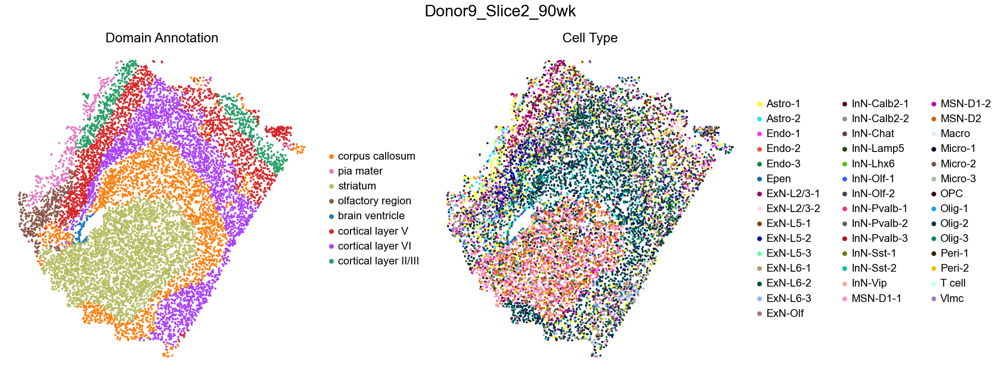

In [18]:
for i in range(len(adata_list)):

    adata = adata_list[i].copy()

    fig, axes = plt.subplots(1, 2, figsize=(21, 8))
    
    sc.pl.embedding(adata_list[i], basis='spatial', palette=domain_color_dict, color='domain_annotation', 
                    ax=axes[0], s=40, show=False, frameon=False, title='Domain Annotation', legend_fontsize=16)
    axes[0].set_title('Domain Annotation', fontsize=20)

    sc.pl.embedding(adata_list[i], basis='spatial', color='celltype_43', 
                    ax=axes[1], s=40, show=False, frameon=False, title='Cell Type', legend_fontsize=16)
    axes[1].set_title('Cell Type', fontsize=20)

    fig.suptitle(f'{slice_name_list[i]}', fontsize=24)
    plt.tight_layout()
    plt.show()